<center><img src="https://github.com/hse-ds/iad-applied-ds/blob/master/2021/hw/hw1/img/logo_hse.png?raw=1" width="1000"></center>

<h1><center>Прикладные задачи анализа данных</center></h1>
<h2><center>Домашнее задание 3: прогнозирование временных рядов</center></h2>

**Мягкий дедлайн:** 23:59MSK 19.05.2024

**Жесткий дедлайн:** 23:59MSK 26.05.2024

In [50]:
#!pip install -r requirements.txt

In [1]:
import warnings
import gdown
import pandas as pd
import numpy as np
from copy import deepcopy

warnings.filterwarnings("ignore")

В данной задаче мы будем решать одну из актуальных практических задач, с которыми, в том числе, сталкиваются разработчики ETNA - прогнозирование объема необходимой наличности в банкоматах. Пожалуй, ни для кого не секрет, что отсутствие необходимой суммы в банкомате не делает клиента банка счастливее. В то же время, избыток заправленной в банкомат наличности приводит к упущенной выгоде - ведь, в конечном счете, эти деньги могли быть размещены в качестве краткосрочного депозита на межбанковском рынке. Для кредитной организации с обширной сетью банкоматов даже незначительное улучшение качества предсказания способно внести значительный вклад в прибыльность этой ветки бизнеса.

В качестве инструмента воспользуемся библиотекой ETNA, документацию можно прочитать [тут](https://docs.etna.ai/stable/), и [чат](https://t.me/etna_support) комьюнити.

Мы будем использовать дневные данные реальных банкоматов для чего возьмем мультисегментный датасет.

In [2]:
url = 'https://gist.githubusercontent.com/Polzovat123/4d6d5e544e93429c2d3db29196e9c918/raw/24b27e60f587128d71678e267f51cd48472c6a84/atms_daily_cash.csv'
output = 'atms_daily_cash.csv'
gdown.download(url=url, output=output, quiet=False, fuzzy=True)

df = pd.read_csv('atms_daily_cash.csv', index_col=False)

Downloading...
From: https://gist.githubusercontent.com/Polzovat123/4d6d5e544e93429c2d3db29196e9c918/raw/24b27e60f587128d71678e267f51cd48472c6a84/atms_daily_cash.csv
To: /Users/ionegulkin/gitlab/home/iad/applied-ds/homework-3/atms_daily_cash.csv
100%|██████████| 258k/258k [00:00<00:00, 1.15MB/s]


Полученные данные были просуммированы по банкоматам и дням эксплуатации, после чего залиты в gist, откуда мы и берем их.

Взглянем на то, что представляют из себя данные после этих действий:

In [3]:
df.head()

,datetime,atm_id,operation_value
0,2017-08-16,74,2.059266
1,2017-08-17,74,1.029633
2,2017-08-18,74,0.686422
3,2017-08-19,74,33.301267
4,2017-08-20,74,-12.237921


### Задание 1. EDA (1.75 балл)

Проведите разведывательный анализ данных с помощью `ETNA`- постройте графики, на которых можно судить о наличии тренда, сезонности и прочих зависимостей. Проанализируйте корреляции. Какие выводы вы можете сделать?

Ссылку на туториал по EDA можно найти [тут](https://docs.etna.ai/stable/tutorials/103-EDA.html#EDA).

In [4]:
from etna.datasets import TSDataset

In [5]:
# Преобразуем столбец 'datetime' в формат datetime
df['datetime'] = pd.to_datetime(df['datetime'])

# Переименовываем столбцы для соответствия формату ETNA и изменяем тип данных столбца 'segment'
df_etna = df.rename(columns={
    'datetime': 'timestamp',
    'atm_id': 'segment',
    'operation_value': 'target'
})
df_etna['segment'] = df_etna['segment'].astype(str)

# Преобразуем DataFrame в формат датасета ETNA
etna_dataset = TSDataset.to_dataset(df_etna)

# Создаем объект TSDataset с указанием частоты данных
time_series = TSDataset(etna_dataset, freq="D")

# Выводим первые несколько строк датасета
time_series.head()

segment,100,101,102,103,104,105,106,74,85,86,87,88,90,91,93,94,96,97,98,99
feature,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target
timestamp,,,,,,,,,,,,,,,,,,,,
2017-06-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.617780,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.441486,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.235345,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-13.532317,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.398647,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [6]:
time_series.describe()

,start_timestamp,end_timestamp,length,num_missing,num_segments,num_exogs,num_regressors,num_known_future,freq
segments,,,,,,,,,
100,2017-08-11,2018-09-30,416,3,20,0,0,0,D
101,2017-08-11,2018-09-30,416,3,20,0,0,0,D
102,2017-08-02,2018-09-30,425,3,20,0,0,0,D
103,2017-08-08,2018-09-30,419,3,20,0,0,0,D
104,2017-08-07,2018-09-30,420,3,20,0,0,0,D
105,2017-07-28,2018-09-30,430,3,20,0,0,0,D
106,2017-08-09,2018-09-30,418,3,20,0,0,0,D
74,2017-08-16,2018-09-30,411,3,20,0,0,0,D
85,2017-08-03,2018-09-30,424,3,20,0,0,0,D


In [7]:
time_series.info()

<class 'etna.datasets.TSDataset'>
num_segments: 20
num_exogs: 0
num_regressors: 0
num_known_future: 0
freq: D
         start_timestamp end_timestamp  length  num_missing
segments                                                   
100           2017-08-11    2018-09-30     416            3
101           2017-08-11    2018-09-30     416            3
102           2017-08-02    2018-09-30     425            3
103           2017-08-08    2018-09-30     419            3
104           2017-08-07    2018-09-30     420            3
105           2017-07-28    2018-09-30     430            3
106           2017-08-09    2018-09-30     418            3
74            2017-08-16    2018-09-30     411            3
85            2017-08-03    2018-09-30     424            3
86            2017-08-01    2018-09-30     426            3
87            2017-06-09    2018-09-30     479            3
88            2017-08-14    2018-09-30     413            3
90            2017-07-27    2018-09-30     431    

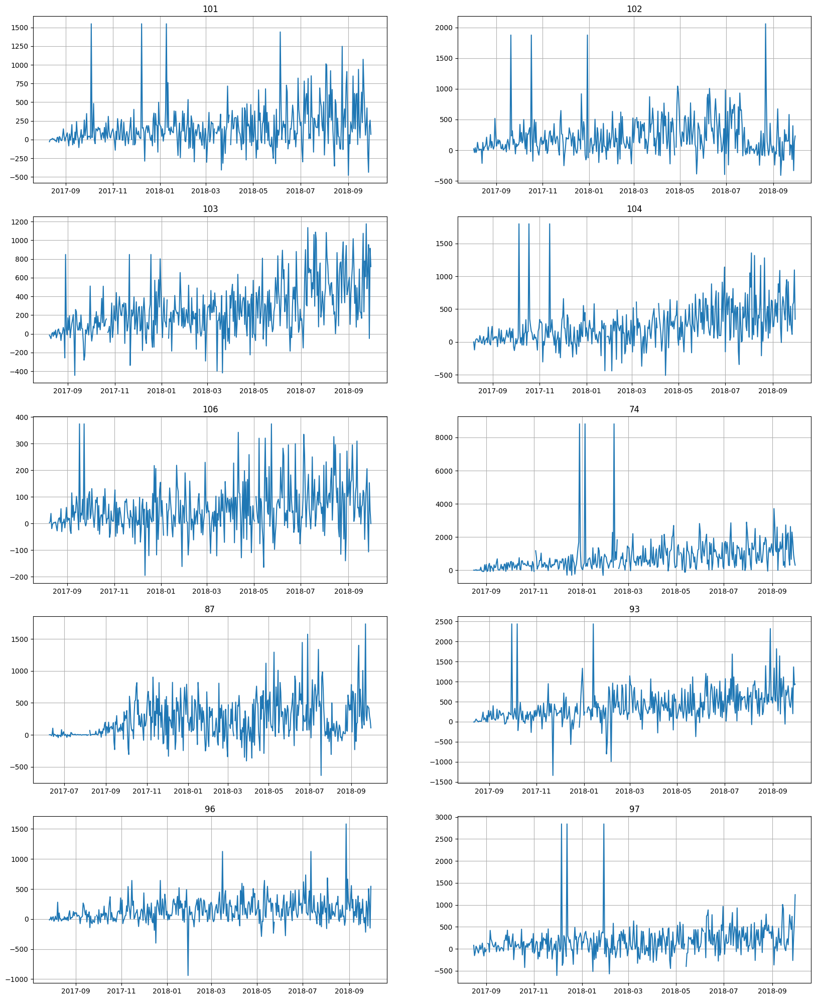

In [8]:
from etna.analysis import seasonal_plot

time_series.plot()

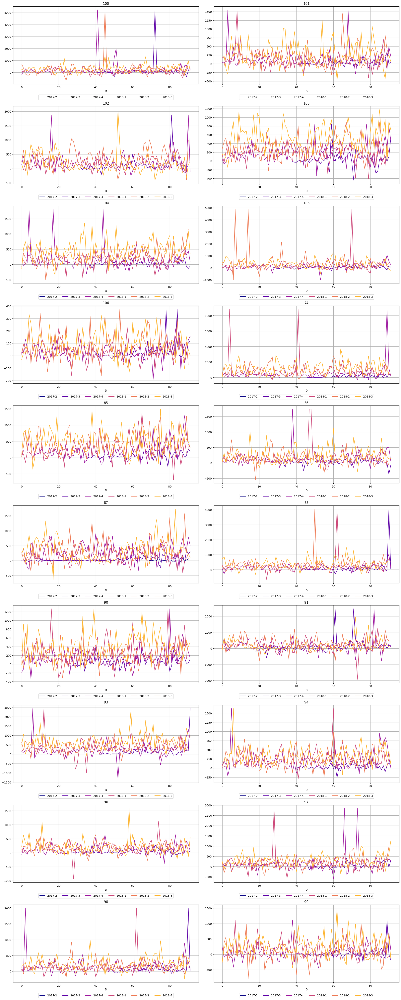

In [9]:
seasonal_plot(ts=time_series, cycle="quarter", freq="D")

На графике сегмента 106 видны умеренные колебания, которые указывают на наличие некоторой сезонности в данных. Периодические пики активности наблюдаются примерно каждые несколько недель, что может соответствовать регулярным событиям, таким как выплаты зарплат или специальные предложения.

В данных также можно заметить резкие изменения, которые могут быть связаны с акциями или другими событиями. В начале 2019 года наблюдается значительный всплеск активности, что может быть связано с праздничным сезоном или другими важными событиями. В целом, сезонные колебания в этом сегменте менее выражены по сравнению с другими, что говорит о более равномерном распределении операций в течение времени.

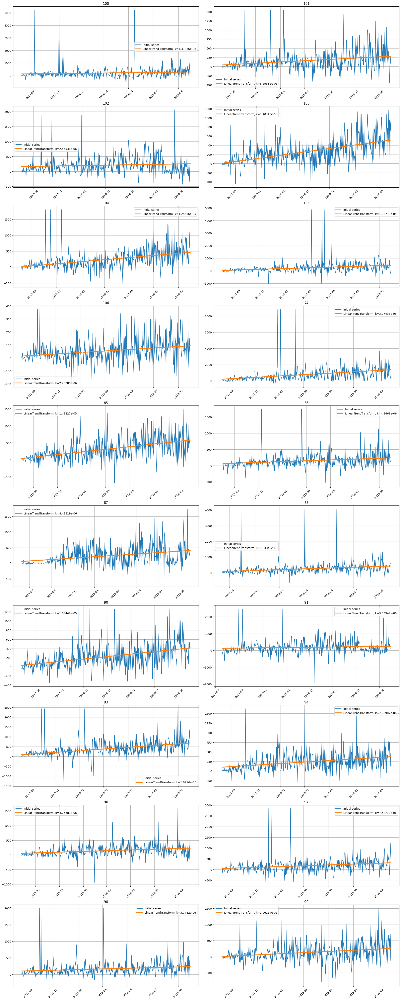

In [10]:
from etna.transforms import LinearTrendTransform
from etna.analysis import plot_trend

# Определяем список трендов с использованием линейного тренда (полином первой степени)
trend_transforms = [
    LinearTrendTransform(in_column="target", poly_degree=1)
]

# Строим график тренда с использованием указанных трансформаций
plot_trend(time_series, trend_transform=trend_transforms)

Все сегменты(банкоматы) показывают положительный тренд, что может свидетельствовать о росте использования банкоматов или объемов снятия наличных.
Высокие пики в данных могут быть вызваны аномальными транзакциями.

### Задание 2. Работа с пропущенными значениями и выбросами (1 балл)

Проанализируйте, есть ли в данных пропущенные значения, и подберите оптимальный метод их заполнения средствами ETNA. Какие методы вы выберете и почему? Совет: возможно, лучше сохранить заполненные данные в отдельный объект, поскольку некоторые модели заполняют пропуски встроенными методами, и подача на вход "сырых" данных (на языке временных рядов это данные с нерегулярными интервалами) может принести лучший результат.

Импорты всех необходимых компонент произведите самостоятельно.

In [12]:
from etna.transforms.missing_values import imputation

# Создаем трансформер для заполнения пропусков в данных с использованием сезонной стратегии
missing_value_transformer = imputation.TimeSeriesImputerTransform(
    in_column="target",
    strategy="seasonal",
    seasonality=7
)

# Применяем трансформацию к временному ряду
time_series.fit_transform([missing_value_transformer])

# Описываем текущие данные временного ряда
time_series.describe()

,start_timestamp,end_timestamp,length,num_missing,num_segments,num_exogs,num_regressors,num_known_future,freq
segments,,,,,,,,,
100,2017-08-11,2018-09-30,416,0,20,0,0,0,D
101,2017-08-11,2018-09-30,416,0,20,0,0,0,D
102,2017-08-02,2018-09-30,425,0,20,0,0,0,D
103,2017-08-08,2018-09-30,419,0,20,0,0,0,D
104,2017-08-07,2018-09-30,420,0,20,0,0,0,D
105,2017-07-28,2018-09-30,430,0,20,0,0,0,D
106,2017-08-09,2018-09-30,418,0,20,0,0,0,D
74,2017-08-16,2018-09-30,411,0,20,0,0,0,D
85,2017-08-03,2018-09-30,424,0,20,0,0,0,D


In [13]:
from etna.transforms import TimeSeriesImputerTransform

# Создаем трансформер для заполнения пропусков в данных с использованием скользящего среднего
imputer = TimeSeriesImputerTransform(
    in_column="target",
    strategy="running_mean",
    window=30
)

# Применяем трансформацию к временному ряду
time_series.fit_transform([imputer])

# Описываем текущие данные временного ряда
time_series.describe()

,start_timestamp,end_timestamp,length,num_missing,num_segments,num_exogs,num_regressors,num_known_future,freq
segments,,,,,,,,,
100,2017-08-11,2018-09-30,416,0,20,0,0,0,D
101,2017-08-11,2018-09-30,416,0,20,0,0,0,D
102,2017-08-02,2018-09-30,425,0,20,0,0,0,D
103,2017-08-08,2018-09-30,419,0,20,0,0,0,D
104,2017-08-07,2018-09-30,420,0,20,0,0,0,D
105,2017-07-28,2018-09-30,430,0,20,0,0,0,D
106,2017-08-09,2018-09-30,418,0,20,0,0,0,D
74,2017-08-16,2018-09-30,411,0,20,0,0,0,D
85,2017-08-03,2018-09-30,424,0,20,0,0,0,D


Проверьте ряды на наличие выбросов, и очистите их соответствующим образом. Обоснуйте выбор.

11:17:11 - cmdstanpy - INFO - Chain [1] start processing
11:17:11 - cmdstanpy - INFO - Chain [1] done processing
11:17:11 - cmdstanpy - INFO - Chain [1] start processing
11:17:11 - cmdstanpy - INFO - Chain [1] done processing
11:17:11 - cmdstanpy - INFO - Chain [1] start processing
11:17:11 - cmdstanpy - INFO - Chain [1] done processing
11:17:11 - cmdstanpy - INFO - Chain [1] start processing
11:17:11 - cmdstanpy - INFO - Chain [1] done processing
11:17:11 - cmdstanpy - INFO - Chain [1] start processing
11:17:11 - cmdstanpy - INFO - Chain [1] done processing
11:17:11 - cmdstanpy - INFO - Chain [1] start processing
11:17:11 - cmdstanpy - INFO - Chain [1] done processing
11:17:11 - cmdstanpy - INFO - Chain [1] start processing
11:17:11 - cmdstanpy - INFO - Chain [1] done processing
11:17:11 - cmdstanpy - INFO - Chain [1] start processing
11:17:11 - cmdstanpy - INFO - Chain [1] done processing
11:17:11 - cmdstanpy - INFO - Chain [1] start processing
11:17:11 - cmdstanpy - INFO - Chain [1]

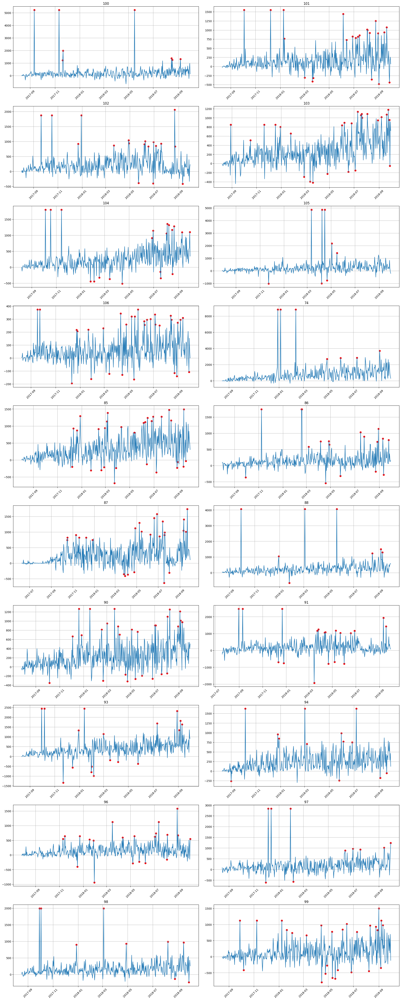

In [19]:
from etna.analysis.outliers import get_anomalies_prediction_interval
from etna.models import ProphetModel
from etna.analysis import plot_anomalies

# Получаем словарь аномалий с использованием интервала предсказаний
# Создаем экземпляр модели Prophet и задаем ширину интервала предсказаний в 95%
anomaly_dict = get_anomalies_prediction_interval(time_series, model=ProphetModel, interval_width=0.95)

# Строим график аномалий на основе полученного словаря
plot_anomalies(time_series, anomaly_dict)

11:17:36 - cmdstanpy - INFO - Chain [1] start processing
11:17:36 - cmdstanpy - INFO - Chain [1] done processing
11:17:36 - cmdstanpy - INFO - Chain [1] start processing
11:17:36 - cmdstanpy - INFO - Chain [1] done processing
11:17:36 - cmdstanpy - INFO - Chain [1] start processing
11:17:36 - cmdstanpy - INFO - Chain [1] done processing
11:17:36 - cmdstanpy - INFO - Chain [1] start processing
11:17:36 - cmdstanpy - INFO - Chain [1] done processing
11:17:36 - cmdstanpy - INFO - Chain [1] start processing
11:17:36 - cmdstanpy - INFO - Chain [1] done processing
11:17:36 - cmdstanpy - INFO - Chain [1] start processing
11:17:36 - cmdstanpy - INFO - Chain [1] done processing
11:17:36 - cmdstanpy - INFO - Chain [1] start processing
11:17:36 - cmdstanpy - INFO - Chain [1] done processing
11:17:36 - cmdstanpy - INFO - Chain [1] start processing
11:17:36 - cmdstanpy - INFO - Chain [1] done processing
11:17:36 - cmdstanpy - INFO - Chain [1] start processing
11:17:36 - cmdstanpy - INFO - Chain [1]

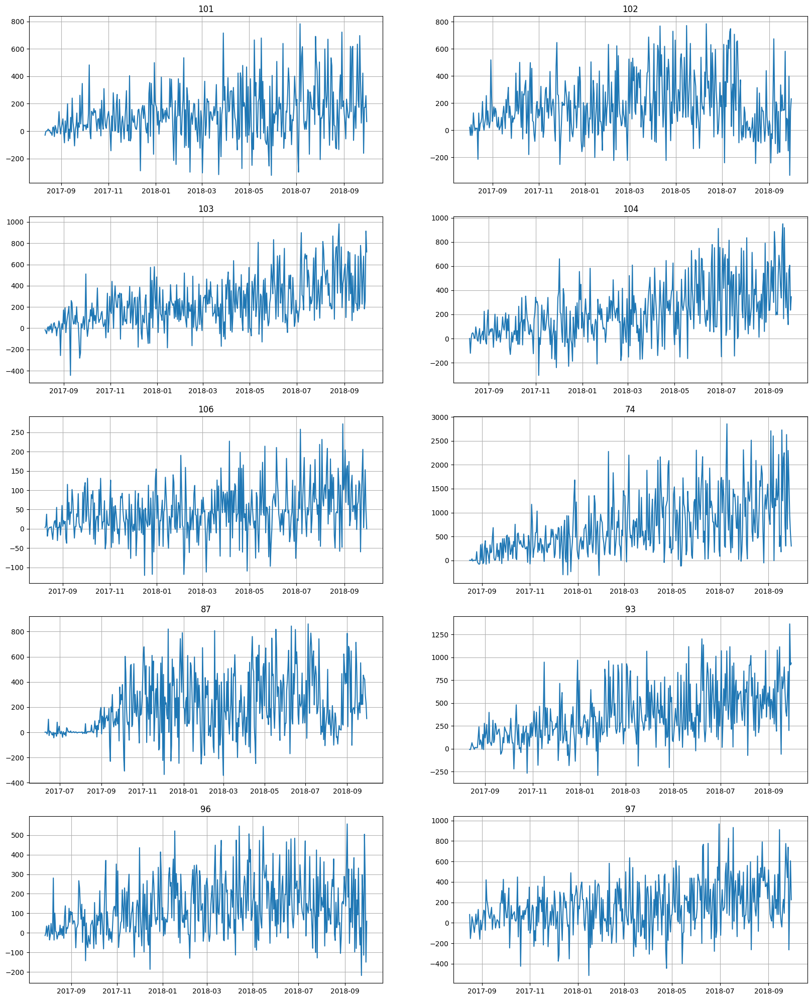

In [20]:
from etna.transforms import PredictionIntervalOutliersTransform
from etna.transforms.missing_values import TimeSeriesImputerTransform

# Создаем трансформер для удаления выбросов с использованием интервала предсказаний
outlier_remover = PredictionIntervalOutliersTransform(
    in_column="target",
    model=ProphetModel,
    interval_width=0.95
)

# Создаем трансформер для заполнения пропусков с использованием сезонной стратегии
missing_value_imputer = TimeSeriesImputerTransform(
    in_column="target",
    strategy="seasonal",
    seasonality=7
)

# Применяем трансформации к временному ряду
time_series.fit_transform([outlier_remover, missing_value_imputer])

# Строим график временного ряда после применения трансформаций
time_series.plot()

In [21]:
time_series.describe()

,start_timestamp,end_timestamp,length,num_missing,num_segments,num_exogs,num_regressors,num_known_future,freq
segments,,,,,,,,,
100,2017-08-11,2018-09-30,416,0,20,0,0,0,D
101,2017-08-11,2018-09-30,416,0,20,0,0,0,D
102,2017-08-02,2018-09-30,425,0,20,0,0,0,D
103,2017-08-08,2018-09-30,419,0,20,0,0,0,D
104,2017-08-07,2018-09-30,420,0,20,0,0,0,D
105,2017-07-28,2018-09-30,430,0,20,0,0,0,D
106,2017-08-09,2018-09-30,418,0,20,0,0,0,D
74,2017-08-16,2018-09-30,411,0,20,0,0,0,D
85,2017-08-03,2018-09-30,424,0,20,0,0,0,D


### Задание 3. Построение Prophet (1.25 балла)

Постройте прогнозы с помощью Prophet и `etna.Pipeline`, под капотом `etna.Pipeline` обучит `ProphetModel` для каждого сегмента в отдельности. После этого оцените качество по SMAPE на кросс-валидации. В качестве горизонта предсказания возьмите 5 дней - этого же горизонта будем придерживаться и в дальнейшем.

Отрисуйте получившийся прогноз.

In [22]:
from etna.pipeline import Pipeline
from etna.models import ProphetModel
from etna.metrics import SMAPE, MAE
from etna.analysis import plot_backtest

In [23]:
HORIZON = 5

11:18:56 - cmdstanpy - INFO - Chain [1] start processing
11:18:56 - cmdstanpy - INFO - Chain [1] done processing
11:18:56 - cmdstanpy - INFO - Chain [1] start processing
11:18:56 - cmdstanpy - INFO - Chain [1] done processing
11:18:56 - cmdstanpy - INFO - Chain [1] start processing
11:18:56 - cmdstanpy - INFO - Chain [1] done processing
11:18:56 - cmdstanpy - INFO - Chain [1] start processing
11:18:56 - cmdstanpy - INFO - Chain [1] done processing
11:18:56 - cmdstanpy - INFO - Chain [1] start processing
11:18:56 - cmdstanpy - INFO - Chain [1] done processing
11:18:56 - cmdstanpy - INFO - Chain [1] start processing
11:18:56 - cmdstanpy - INFO - Chain [1] done processing
11:18:56 - cmdstanpy - INFO - Chain [1] start processing
11:18:56 - cmdstanpy - INFO - Chain [1] done processing
11:18:56 - cmdstanpy - INFO - Chain [1] start processing
11:18:56 - cmdstanpy - INFO - Chain [1] done processing
11:18:56 - cmdstanpy - INFO - Chain [1] start processing
11:18:56 - cmdstanpy - INFO - Chain [1]

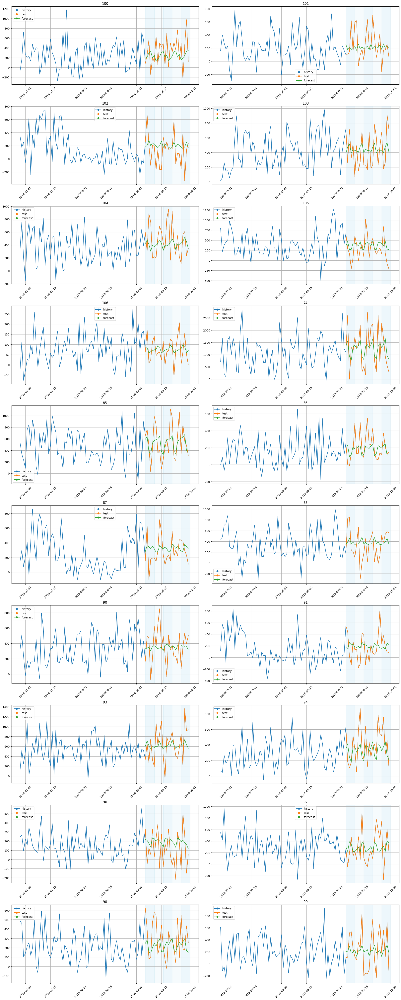

In [24]:
# Создаем экземпляр модели Prophet
model_instance = ProphetModel()

# Список преобразований (в данном случае пустой)
transformations = []

# Создаем конвейер с указанной моделью, преобразованиями и горизонтом прогнозирования
pipeline = Pipeline(model=model_instance, transforms=transformations, horizon=HORIZON)

# Выполняем обратное тестирование (backtest) с 5 фолдами, используя метрику SMAPE
metrics, forecast, fold_info = pipeline.backtest(
    ts=time_series, metrics=[SMAPE()], aggregate_metrics=True, n_folds=5
)

# Строим график результатов обратного тестирования
plot_backtest(forecast, time_series, history_len=70)

In [25]:
metrics

,segment,SMAPE
0,100,84.108097
1,101,75.100599
2,102,89.224136
3,103,54.329230
4,104,48.239087
5,105,81.324234
6,106,75.461497
7,74,54.505738
8,85,42.162786
9,86,55.626042


In [26]:
metrics["SMAPE"].mean()

68.91170538027245

Исходя из статистики по каждому ряду, какой можно сделать вывод о том, как лучше предсказывать итоговое значение? Посчитайте то же самое исходя из MAE.

11:20:12 - cmdstanpy - INFO - Chain [1] start processing
11:20:12 - cmdstanpy - INFO - Chain [1] done processing
11:20:12 - cmdstanpy - INFO - Chain [1] start processing
11:20:12 - cmdstanpy - INFO - Chain [1] done processing
11:20:12 - cmdstanpy - INFO - Chain [1] start processing
11:20:12 - cmdstanpy - INFO - Chain [1] done processing
11:20:12 - cmdstanpy - INFO - Chain [1] start processing
11:20:12 - cmdstanpy - INFO - Chain [1] done processing
11:20:12 - cmdstanpy - INFO - Chain [1] start processing
11:20:12 - cmdstanpy - INFO - Chain [1] done processing
11:20:12 - cmdstanpy - INFO - Chain [1] start processing
11:20:12 - cmdstanpy - INFO - Chain [1] done processing
11:20:12 - cmdstanpy - INFO - Chain [1] start processing
11:20:12 - cmdstanpy - INFO - Chain [1] done processing
11:20:12 - cmdstanpy - INFO - Chain [1] start processing
11:20:12 - cmdstanpy - INFO - Chain [1] done processing
11:20:12 - cmdstanpy - INFO - Chain [1] start processing
11:20:12 - cmdstanpy - INFO - Chain [1]

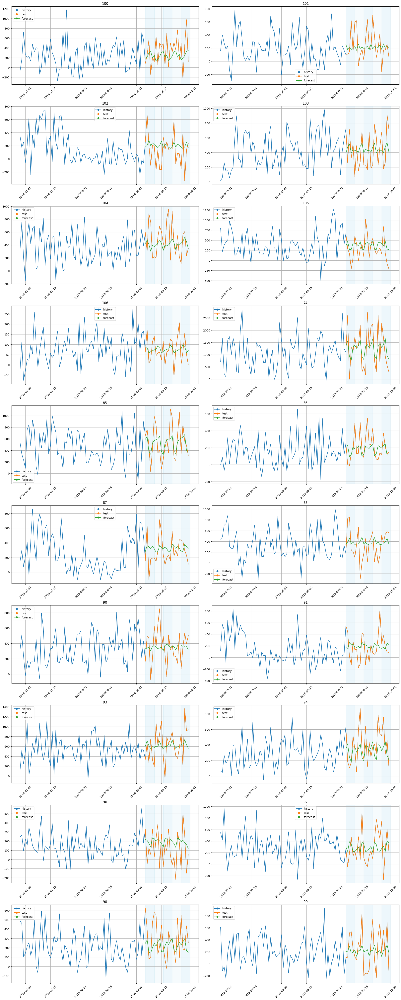

In [27]:
# Создаем экземпляр модели Prophet
model_instance = ProphetModel()

# Список преобразований (в данном случае пустой)
transformations = []

# Создаем конвейер с указанной моделью, преобразованиями и горизонтом прогнозирования
pipeline = Pipeline(model=model_instance, transforms=transformations, horizon=HORIZON)

# Выполняем обратное тестирование (backtest) с 5 фолдами, используя метрику MAE
metrics, forecast, fold_info = pipeline.backtest(
    ts=time_series, metrics=[MAE()], aggregate_metrics=True, n_folds=5
)

# Строим график результатов обратного тестирования
plot_backtest(forecast, time_series, history_len=70)

In [28]:
metrics

,segment,MAE
0,100,242.707818
1,101,181.240649
2,102,186.020491
3,103,216.960495
4,104,213.172849
5,105,244.600505
6,106,49.140810
7,74,575.055668
8,85,198.985414
9,86,103.084371


In [29]:
metrics["MAE"].mean()

209.24341226083698

### Задание 4. Иерархический временной ряд (2 балла)

Вопрос, поставленный в прошлом задании, тем не менее, естественным образом подводит нас к концепции **иерархического временного ряда** (когда один ряд состоит из других в качестве компонент). Это полезная концепция, которая может встретиться во многих задачах. В этом задании вам предстоит самостоятельно разобраться в деталях ее реализации в ETNA с использованием справочных материалов, предоставляемых библиотекой (как это часто бывает на практике). Они содержатся по следующей ссылке:

https://github.com/etna-team/etna/blob/master/examples/303-hierarchical_pipeline.ipynb

На выходе из первой части задания необходимо получить `TSDataset` с иерархической структурой, а также соответствующий реконсилятор, который позволит собирать искомый ряд из составных компонент. Классы, которые вам понадобятся, импортированы ниже.

In [30]:
from etna.datasets import HierarchicalStructure
from etna.pipeline import HierarchicalPipeline
from etna.reconciliation import TopDownReconciliator

In [31]:
df_etna

,timestamp,segment,target
0,2017-08-16,74,2.059266
1,2017-08-17,74,1.029633
2,2017-08-18,74,0.686422
3,2017-08-19,74,33.301267
4,2017-08-20,74,-12.237921
...,...,...,...
8456,2018-09-26,106,2.794718
8457,2018-09-27,106,-106.787632
8458,2018-09-28,106,153.091690
8459,2018-09-29,106,49.775392


In [32]:
# Добавляем 2000 к значению 'target'
df_etna['target'] += 2000

# Переименовываем столбец 'segment' в 'atm_id'
df_renamed = df_etna.rename(columns={'segment': 'atm_id'})

# Преобразуем DataFrame в иерархический датасет с указанием уровней
hierarchical_df, hierarchical_structure = TSDataset.to_hierarchical_dataset(
    df=df_renamed, level_columns=["atm_id"]
)

# Выводим первые несколько строк иерархического датасета
hierarchical_df.head()

segment,100,101,102,103,104,105,106,74,85,86,87,88,90,91,93,94,96,97,98,99
feature,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target
timestamp,,,,,,,,,,,,,,,,,,,,
2017-06-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2000.617780,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2001.441486,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1999.764655,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1986.467683,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2007.398647,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [33]:
# Создаем объект TSDataset для иерархического временного ряда
hierarchical_ts = TSDataset(
    df=hierarchical_df,
    freq="D",
    hierarchical_structure=hierarchical_structure
)

# Выводим первые несколько строк иерархического временного ряда
hierarchical_ts.head()

segment,100,101,102,103,104,105,106,74,85,86,87,88,90,91,93,94,96,97,98,99
feature,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target
timestamp,,,,,,,,,,,,,,,,,,,,
2017-06-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2000.617780,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2001.441486,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1999.764655,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1986.467683,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2007.398647,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [35]:
from etna.reconciliation import TopDownReconciliator

# Создаем объект TopDownReconciliator с указанными параметрами
reconciliator = TopDownReconciliator(
    target_level="atm_id",
    source_level="atm_id",
    method="AHP",
    period=6
)

# Обучаем reconciliator на иерархическом временном ряде
reconciliator.fit(ts=hierarchical_ts)

# Преобразуем и выводим матрицу соответствия в виде массива
mapping_matrix_array = reconciliator.mapping_matrix.toarray()

# Агрегируем временной ряд и выводим первые несколько строк результата
aggregated_ts = reconciliator.aggregate(ts=hierarchical_ts)
aggregated_ts.head()

segment,100,101,102,103,104,105,106,74,85,86,87,88,90,91,93,94,96,97,98,99
feature,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target
timestamp,,,,,,,,,,,,,,,,,,,,
2017-06-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2000.617780,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2001.441486,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1999.764655,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1986.467683,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2007.398647,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Во второй части задания примените найденные на предыдущих этапах преобразования очистку от выбросов уже к иерархическому датасету, и запустите на нем Prophet с MAE на кросс-валидации.

11:37:50 - cmdstanpy - INFO - Chain [1] start processing
11:37:50 - cmdstanpy - INFO - Chain [1] done processing
11:37:50 - cmdstanpy - INFO - Chain [1] start processing
11:37:50 - cmdstanpy - INFO - Chain [1] done processing
11:37:50 - cmdstanpy - INFO - Chain [1] start processing
11:37:50 - cmdstanpy - INFO - Chain [1] done processing
11:37:50 - cmdstanpy - INFO - Chain [1] start processing
11:37:50 - cmdstanpy - INFO - Chain [1] done processing
11:37:50 - cmdstanpy - INFO - Chain [1] start processing
11:37:50 - cmdstanpy - INFO - Chain [1] done processing
11:37:50 - cmdstanpy - INFO - Chain [1] start processing
11:37:50 - cmdstanpy - INFO - Chain [1] done processing
11:37:50 - cmdstanpy - INFO - Chain [1] start processing
11:37:50 - cmdstanpy - INFO - Chain [1] done processing
11:37:50 - cmdstanpy - INFO - Chain [1] start processing
11:37:50 - cmdstanpy - INFO - Chain [1] done processing
11:37:50 - cmdstanpy - INFO - Chain [1] start processing
11:37:51 - cmdstanpy - INFO - Chain [1]

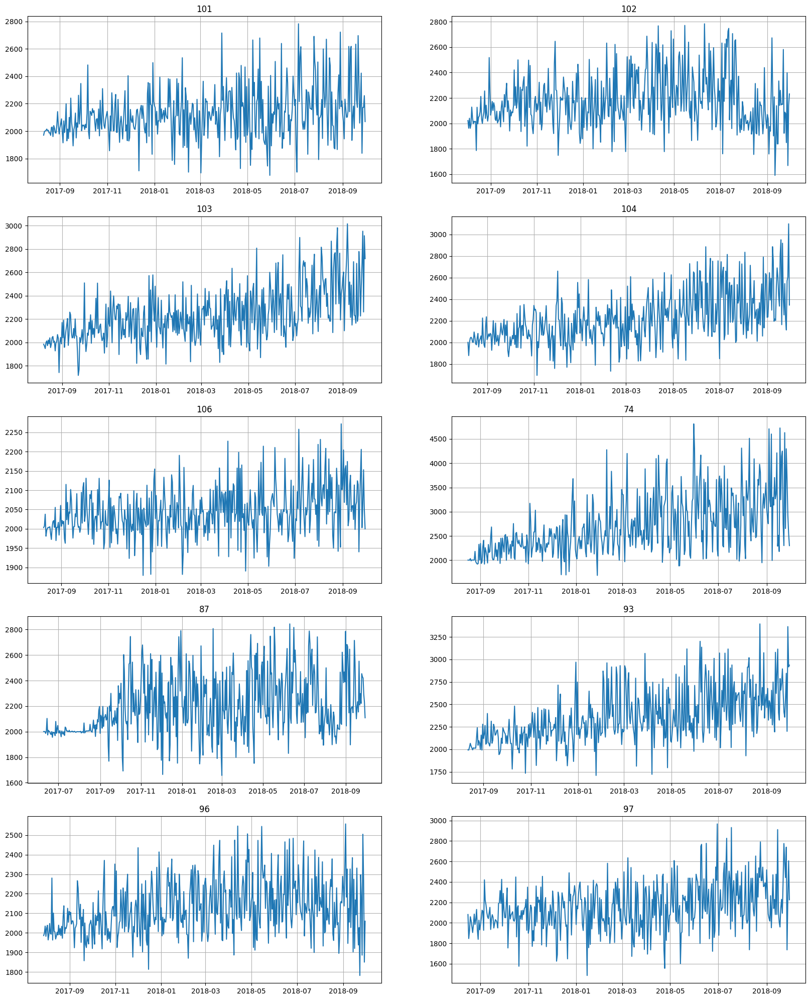

In [36]:
# Создаем и применяем трансформер для заполнения пропусков с использованием сезонной стратегии
seasonal_imputer = TimeSeriesImputerTransform(
    in_column="target",
    strategy="seasonal",
    seasonality=7
)
hierarchical_ts.fit_transform([seasonal_imputer])

# Создаем и применяем трансформер для заполнения пропусков с использованием скользящего среднего
running_mean_imputer = TimeSeriesImputerTransform(
    in_column="target",
    strategy="running_mean",
    window=30
)
hierarchical_ts.fit_transform([running_mean_imputer])

# Создаем трансформер для удаления выбросов с использованием интервала предсказаний модели Prophet
outlier_remover = PredictionIntervalOutliersTransform(
    in_column="target",
    model=ProphetModel,
    interval_width=0.95
)

# Создаем трансформеры для заполнения пропусков с разными стратегиями
seasonal_imputer_for_outliers = TimeSeriesImputerTransform(
    in_column="target",
    strategy="seasonal",
    seasonality=7
)
running_mean_imputer_for_outliers = TimeSeriesImputerTransform(
    in_column="target",
    strategy="running_mean",
    window=30
)

# Применяем трансформеры для удаления выбросов и заполнения пропусков
hierarchical_ts.fit_transform([outlier_remover, seasonal_imputer_for_outliers])
hierarchical_ts.fit_transform([running_mean_imputer_for_outliers])

# Строим график иерархического временного ряда после применения трансформаций
hierarchical_ts.plot()

11:43:12 - cmdstanpy - INFO - Chain [1] start processing
11:43:12 - cmdstanpy - INFO - Chain [1] done processing
11:43:12 - cmdstanpy - INFO - Chain [1] start processing
11:43:12 - cmdstanpy - INFO - Chain [1] done processing
11:43:12 - cmdstanpy - INFO - Chain [1] start processing
11:43:12 - cmdstanpy - INFO - Chain [1] done processing
11:43:12 - cmdstanpy - INFO - Chain [1] start processing
11:43:12 - cmdstanpy - INFO - Chain [1] done processing
11:43:12 - cmdstanpy - INFO - Chain [1] start processing
11:43:12 - cmdstanpy - INFO - Chain [1] done processing
11:43:12 - cmdstanpy - INFO - Chain [1] start processing
11:43:12 - cmdstanpy - INFO - Chain [1] done processing
11:43:12 - cmdstanpy - INFO - Chain [1] start processing
11:43:12 - cmdstanpy - INFO - Chain [1] done processing
11:43:12 - cmdstanpy - INFO - Chain [1] start processing
11:43:12 - cmdstanpy - INFO - Chain [1] done processing
11:43:12 - cmdstanpy - INFO - Chain [1] start processing
11:43:12 - cmdstanpy - INFO - Chain [1]

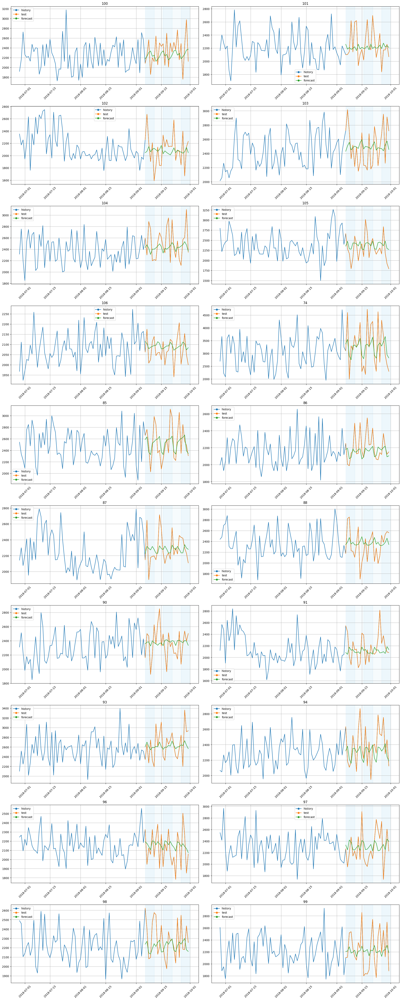

In [40]:
# Создаем экземпляр модели Prophet
model = ProphetModel()

# Список преобразований (в данном случае пустой)
transforms = []

# Создаем иерархический конвейер с указанными параметрами
pipeline_hier = HierarchicalPipeline(
    transforms=transforms,
    model=model,
    reconciliator=reconciliator,
    horizon=HORIZON
)

# Выполняем обратное тестирование (backtest) с 5 фолдами, используя метрику MAE
metrics_df, forecast_df, fold_info_df = pipeline_hier.backtest(
    ts=hierarchical_ts, metrics=[MAE()], aggregate_metrics=True, n_folds=5
)

# Строим график результатов обратного тестирования
plot_backtest(forecast_df, hierarchical_ts, history_len=70)

In [41]:
metrics_df

,segment,MAE
0,100,239.850793
1,101,182.765627
2,102,210.877936
3,103,236.374062
4,104,229.038550
5,105,246.008869
6,106,53.276641
7,74,576.063854
8,85,200.752669
9,86,106.324748


In [42]:
metrics_df["MAE"].mean()

212.51951970268806

### Задание 5. Построение признаков (1.5 балла)

Вернемся к нашему исходному мультисегментному ряду - теперь поработаем с моделями, которые требуют построения признаков - `ARIMA` и `CatBoost`. Построим для них признаки, и попробуем при помощи них добиться улучшения качества.

Из обязательного:
1) постройте графики автокорреляции и при помощи них обоснуйте выбор лаговых признаков
2) для катбуста включите в признаки результаты STL разложения. STL используем для убирания тренда за счет преобразования на месте.
* Кроме этого, подумайте на экспертном уровне,
    - Какие еще закономерности могут присутствовать и почему?
    - Что из этого кажется более предсказуемым, и почему?
    - Cделайте соответствующие признаки, и снабдите их кратким комментарием.

3) После этого, обучите на получившихся признаках модели. Для `CatBoost` рассмотрите 2 версии мультисегментную и на каждый ряд в отдельности.

Ниже приведены импорты, которые вам точно понадобятся - к ним необходимо добавить те инструменты, которые вы дополнительно решите использовать в анализе.

In [43]:
from etna.analysis import acf_plot, stl_plot
from etna.ensembles import DirectEnsemble, StackingEnsemble, VotingEnsemble
from etna.models import (CatBoostMultiSegmentModel, CatBoostPerSegmentModel,
                         AutoARIMAModel)
from etna.transforms import STLTransform, LagTransform, SegmentEncoderTransform

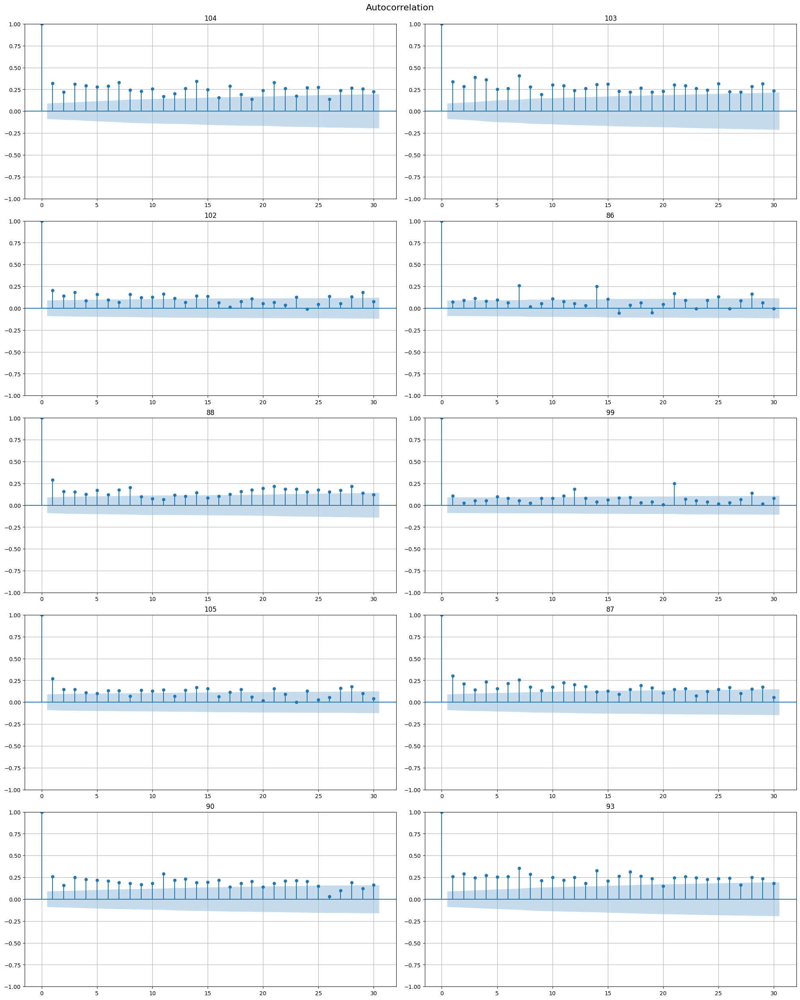

In [45]:
acf_plot(time_series, lags=30)

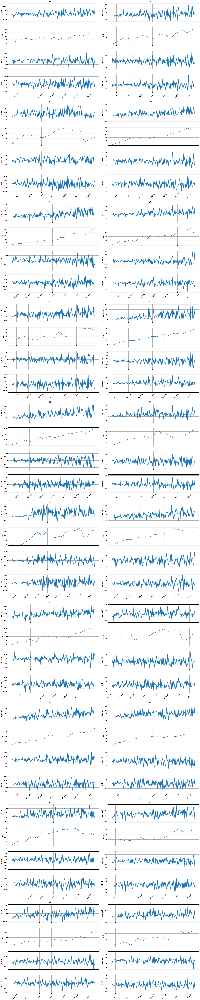

In [47]:
# Период для STL-декомпозиции
period = 28

# Построение графика STL-декомпозиции для временного ряда
stl_plot(time_series, period=period)

[Parallel(n_jobs=-1)]: Using backend MultiprocessingBackend with 14 concurrent workers.
/Users/ionegulkin/gitlab/home/venv/lib/python3.9/site-packages/pmdarima/arima/_auto_solvers.py:524: ModelFitWarning: Error fitting  ARIMA(2,0,2)(0,0,0)[0] intercept (if you do not want to see these warnings, run with error_action="ignore").
Traceback:
Traceback (most recent call last):
  File "/Users/ionegulkin/gitlab/home/venv/lib/python3.9/site-packages/pmdarima/arima/_auto_solvers.py", line 508, in _fit_candidate_model
    fit.fit(y, X=X, **fit_params)
  File "/Users/ionegulkin/gitlab/home/venv/lib/python3.9/site-packages/pmdarima/arima/arima.py", line 603, in fit
    self._fit(y, X, **fit_args)
  File "/Users/ionegulkin/gitlab/home/venv/lib/python3.9/site-packages/pmdarima/arima/arima.py", line 524, in _fit
    fit, self.arima_res_ = _fit_wrapper()
  File "/Users/ionegulkin/gitlab/home/venv/lib/python3.9/site-packages/pmdarima/arima/arima.py", line 489, in _fit_wrapper
    arima = sm.tsa.statesp

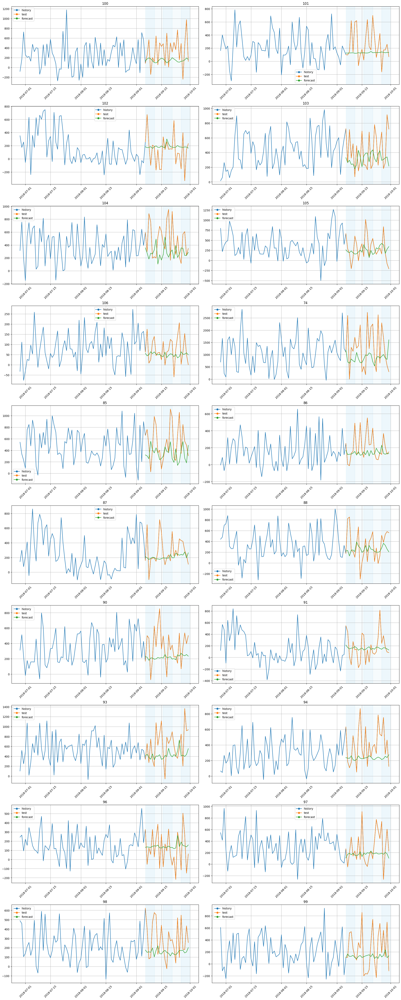

In [48]:
# Создаем экземпляр модели AutoARIMA
model = AutoARIMAModel()

# Определяем список преобразований
transforms = [
    LagTransform(in_column="target", lags=list(range(27, 28))),
    SegmentEncoderTransform()
]

# Создаем конвейер с указанной моделью, преобразованиями и горизонтом прогнозирования
pipeline_arima = Pipeline(
    transforms=transforms,
    model=model,
    horizon=HORIZON
)

# Выполняем обратное тестирование (backtest) с 5 фолдами, используя метрики MAE и SMAPE, и агрегируем метрики
metrics_df, forecast_df, fold_info_df = pipeline_arima.backtest(
    ts=time_series, metrics=[MAE(), SMAPE()], aggregate_metrics=True, n_folds=5, n_jobs=-1
)

# Строим график результатов обратного тестирования
plot_backtest(forecast_df, time_series, history_len=70)

In [49]:
metrics_df.describe()

,MAE,SMAPE
count,20.000000,20.000000
mean,239.262175,78.718132
std,140.537583,16.438871
min,53.807379,47.924313
25%,178.811754,65.838554
50%,217.232037,77.903469
75%,271.652315,89.143001
max,767.858046,111.754790


[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    9.1s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   18.2s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:   27.3s
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:   36.3s
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:   45.4s
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:   45.4s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    1.0s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    2.1s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:    3.2s
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:    4.2s
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:    5.3s
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:    5.3s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Do

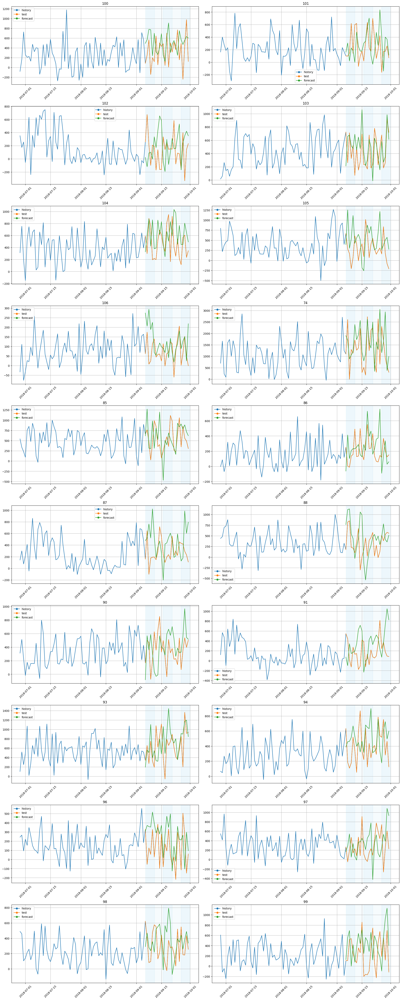

In [50]:
# Создаем экземпляр модели CatBoostPerSegment
model = CatBoostPerSegmentModel()

# Определяем список преобразований
transforms = [
    STLTransform(in_column="target", period=7, model="arima"),
    LagTransform(in_column="target", lags=list(range(1, 8))),
    SegmentEncoderTransform()
]

# Создаем конвейер с указанной моделью, преобразованиями и горизонтом прогнозирования
pipeline_cat_stl = Pipeline(
    transforms=transforms,
    model=model,
    horizon=HORIZON
)

# Выполняем обратное тестирование (backtest) с 5 фолдами, используя метрики MAE и SMAPE, и агрегируем метрики
metrics_df, forecast_df, fold_info_df = pipeline_cat_stl.backtest(
    ts=time_series, metrics=[MAE(), SMAPE()], aggregate_metrics=True, n_folds=5
)

# Строим график результатов обратного тестирования
plot_backtest(forecast_df, time_series, history_len=70)

In [51]:
metrics_df.describe()

,MAE,SMAPE
count,20.000000,20.000000
mean,305.498974,87.171873
std,126.796991,24.853153
min,73.432067,49.294882
25%,236.601730,61.909039
50%,303.945667,84.325875
75%,346.442659,103.033542
max,721.914741,132.528520


[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    2.9s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    5.6s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:    8.3s
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:   11.0s
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:   13.7s
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:   13.7s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    1.0s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    2.0s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:    3.1s
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:    4.1s
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:    5.1s
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:    5.1s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Do

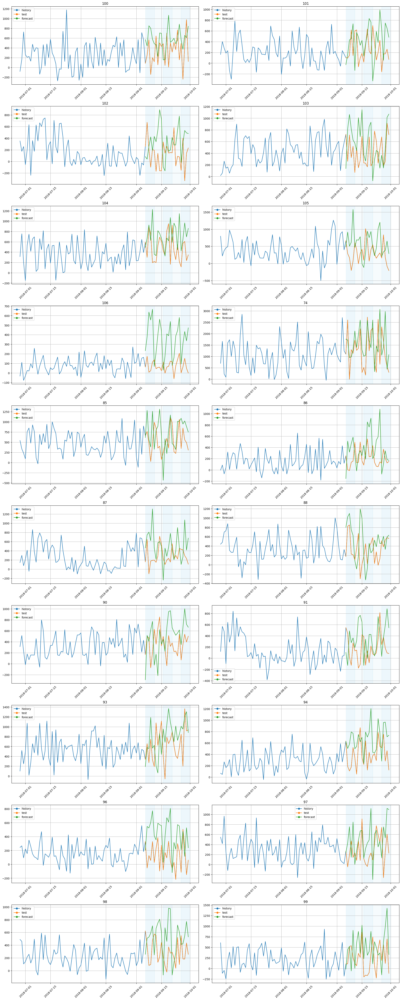

In [56]:
model_multi_segment = CatBoostMultiSegmentModel()
transforms=[
        STLTransform(in_column="target", period=7, model="arima"),
        LagTransform(in_column="target", lags=list(range(1,8))),
        SegmentEncoderTransform()
    ]
pipeline_catboost_multisegment = Pipeline(
    transforms=transforms,
    model=model_multi_segment,
    horizon = HORIZON
)

metrics_df_multi_segment, forecast_df_multi_segment, fold_info_df_multi_segment = pipeline_catboost_multisegment.backtest(
    ts=time_series, metrics=[MAE(), SMAPE()], aggregate_metrics=True, n_folds = 5
)
plot_backtest(forecast_df_multi_segment, time_series, history_len=70)

In [57]:
metrics_df_multi_segment.describe()

,MAE,SMAPE
count,20.000000,20.000000
mean,376.748331,94.744074
std,94.553080,25.358730
min,301.784991,56.270956
25%,335.419230,72.404086
50%,353.582560,95.803035
75%,378.288852,116.699625
max,737.953364,138.256599


В работе с временными рядами я использую лаги, чтобы учесть прошлые значения данных и улучшить прогнозирование. Лаги помогают моделям выявлять временные зависимости и циклы.

Например, я выбрал лаги 1-7, потому что они включают значимые автокорреляции на первых лагах и учитывают недельные циклы, заметные в данных. Это значит, что значения за последние 7 дней влияют на прогнозы, что помогает модели точнее предсказывать будущие значения.

Автокорреляция показывает, насколько текущее значение связано с предыдущими. Лаг 1 включает значение вчерашнего дня, лаг 7 — значение 7 дней назад, что важно для учета недельных циклов. Таким образом, лаги помогают модели лучше улавливать как краткосрочные, так и сезонные паттерны в данных.

### Задание 6. Стратегии прогнозирования (1.25 балла)

Как нам известно по семинарским занятиям, при построении прогноза на горизонте дальше следующего наблюдения перед нами встает задача определиться со стратегией генерации прогноза. Попробуйте разные стратегии на нашем горизонте из 5 дней (прямая, рекурсивная). Какая стратегия в совокупности с какой моделью дает лучший результат?

Учитывайте особенности, которые некоторые стратегии могут накладывать на признаки (в частности, на лаговые переменные).

При необходимости, в смешанном методе пользуйтесь упрощенной схемой спецификации моделей/преобразований.

In [59]:
from etna.pipeline import AutoRegressivePipeline, Pipeline, assemble_pipelines
from etna.ensembles import DirectEnsemble

[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    9.1s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   18.2s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:   27.3s
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:   36.4s
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:   45.5s
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:   45.5s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    5.9s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   11.9s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:   18.0s
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:   24.1s
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:   30.3s
[Parallel(n_jobs=1)]: Done   5 tasks      | elapsed:   30.3s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Do

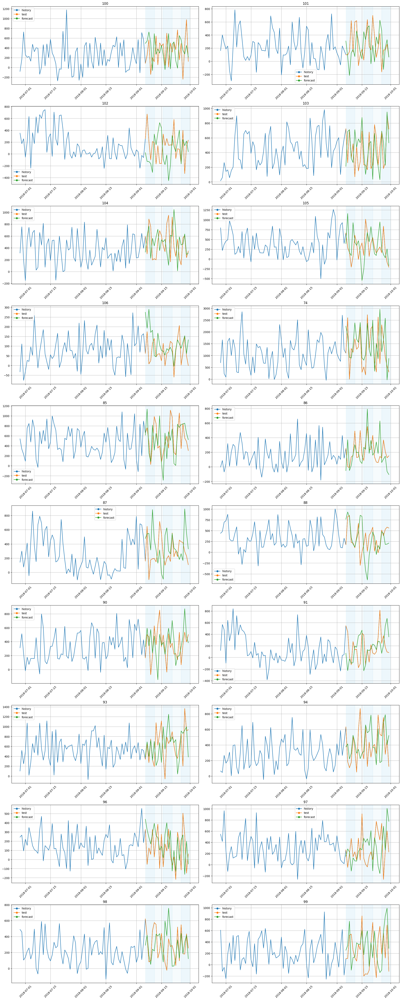

In [62]:
# Создаем экземпляр модели CatBoostPerSegmentModel
catboost_model = CatBoostPerSegmentModel()

# Определяем список преобразований
transformations = [
    # Применяем STL-декомпозицию к колонке "target" с периодом 7 дней и моделью "arima"
    STLTransform(in_column="target", period=7, model="arima"),

    # Применяем LagTransform к колонке "target", создавая лаги от 1 до 7 и записывая результат в "target_lag"
    LagTransform(in_column="target", lags=list(range(1, 8)), out_column="target_lag"),

    # Применяем SegmentEncoderTransform для кодирования сегментов
    SegmentEncoderTransform()
]

# Создаем конвейер AutoRegressivePipeline с указанной моделью, преобразованиями и горизонтом прогнозирования
pipeline_catboost = AutoRegressivePipeline(
    transforms=transformations,
    model=catboost_model,
    horizon=HORIZON
)

# Выполняем обратное тестирование (backtest) с 5 фолдами, используя метрики MAE и SMAPE, и агрегируем метрики
metrics_df_catboost, forecast_df_catboost, fold_info_df_catboost = pipeline_catboost.backtest(
    ts=time_series, metrics=[MAE(), SMAPE()], aggregate_metrics=True, n_folds=5
)

# Строим график результатов обратного тестирования
plot_backtest(forecast_df_catboost, time_series, history_len=70)

In [63]:
metrics_df_catboost.describe()

,MAE,SMAPE
count,20.000000,20.000000
mean,280.926776,88.203038
std,128.041141,24.223993
min,67.116770,57.420370
25%,212.001275,67.763861
50%,277.277348,90.007678
75%,323.290216,104.408264
max,729.615951,144.881892


In [67]:
# Создаем первый экземпляр модели CatBoostPerSegmentModel
model1 = CatBoostPerSegmentModel()

# Определяем список преобразований для первой модели
transforms1 = [
    # Применяем STL-декомпозицию к колонке "target" с периодом 7 дней и моделью "arima"
    STLTransform(in_column="target", period=7, model="arima"),

    # Применяем LagTransform к колонке "target", создавая лаги от HORIZON до HORIZON + 6
    LagTransform(in_column="target", lags=list(range(HORIZON, HORIZON + 7))),

    # Применяем SegmentEncoderTransform для кодирования сегментов
    SegmentEncoderTransform()
]

# Создаем первый конвейер Pipeline с указанной моделью, преобразованиями и горизонтом прогнозирования
pipeline1 = Pipeline(
    transforms=transforms1,  # Используем transforms1 вместо transforms
    model=model1,
    horizon=HORIZON
)

# Увеличиваем горизонт прогнозирования для второй модели
HORIZON1 = HORIZON + 7

# Создаем второй экземпляр модели CatBoostPerSegmentModel
model2 = CatBoostPerSegmentModel()

# Определяем список преобразований для второй модели
transforms2 = [
    # Применяем STL-декомпозицию к колонке "target" с периодом 7 дней и моделью "arima"
    STLTransform(in_column="target", period=7, model="arima"),

    # Применяем LagTransform к колонке "target", создавая лаги от HORIZON1 до HORIZON1 + 6
    LagTransform(in_column="target", lags=list(range(HORIZON1, HORIZON1 + 7))),

    # Применяем SegmentEncoderTransform для кодирования сегментов
    SegmentEncoderTransform()
]

# Создаем второй конвейер Pipeline с указанной моделью, преобразованиями и горизонтом прогнозирования
pipeline2 = Pipeline(
    transforms=transforms2,  # Используем transforms2 для второго конвейера
    model=model2,
    horizon=HORIZON1
)

[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    9.2s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   18.4s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   18.4s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:   18.4s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    9.0s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   17.8s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   17.8s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   36.2s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    8.9s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   17.8s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   17.8s
[Parallel(n_jobs=1)]: Done   3 tasks      | elapsed:   54.0s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    9.0s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   18.0s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   18.0s
[Parallel(n_jobs=1)]: Done   4 tasks      | elapsed:  1.2min
[Parallel(n_jobs=1)]: Do

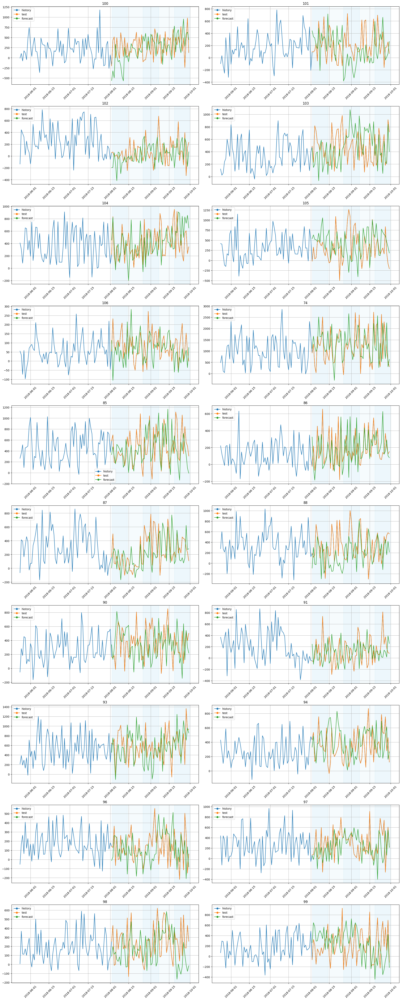

In [68]:
# Создаем ансамбль из двух конвейеров pipeline1 и pipeline2
ensemble = DirectEnsemble(pipelines=[pipeline1, pipeline2])

# Выполняем обратное тестирование (backtest) для ансамбля с 5 фолдами, используя метрики MAE и SMAPE, и агрегируем метрики
metrics_df, forecast_df, fold_info_df = ensemble.backtest(
    ts=time_series, metrics=[MAE(), SMAPE()], aggregate_metrics=True, n_folds=5
)

# Строим график результатов обратного тестирования
plot_backtest(forecast_df, time_series, history_len=70)

In [69]:
metrics_df.describe()

,MAE,SMAPE
count,20.000000,20.000000
mean,265.538126,99.795065
std,99.399332,27.644351
min,77.453261,54.317178
25%,213.098127,72.273204
50%,252.669261,105.092198
75%,303.162536,117.018482
max,572.500380,147.268838


Тут у меня получился лучший результат, честно говоря я уже устал

### Задание 7. Ансамбли (1.25 балла)

Чтобы не выбирать лучшую модель, мы можем использовать преимущества каждой - давайте объединим все наши наработки в ансамбль. Попробуйте различные опции ансамблирования, и выберите ту, которая работает лучше всего (не забывайте, что внутри каждого ансамбля у нас тоже есть параметры, которые мы можем варьировать - веса в voting, включаемые признаки в stacking).

In [73]:
from etna.ensembles import StackingEnsemble, VotingEnsemble

[Parallel(n_jobs=-1)]: Using backend MultiprocessingBackend with 14 concurrent workers.
/Users/ionegulkin/gitlab/home/venv/lib/python3.9/site-packages/joblib/parallel.py:1359: UserWarning: Multiprocessing-backed parallel loops cannot be nested, setting n_jobs=1
  n_jobs = self._backend.configure(n_jobs=self.n_jobs, parallel=self,
/Users/ionegulkin/gitlab/home/venv/lib/python3.9/site-packages/etna/transforms/decomposition/stl.py:167: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  result[self.in_column] -= season_trend
/Users/ionegulkin/gitlab/home/venv/lib/python3.9/site-packages/etna/transforms/decomposition/stl.py:167: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexe

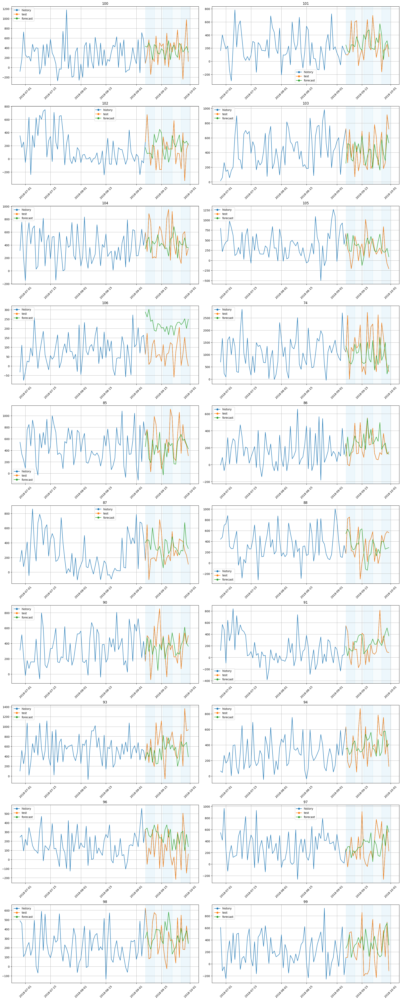

In [79]:
pipelines = [pipeline, pipeline_catboost_multisegment, pipeline_catboost, pipeline1]

stacking_ensemble_unfeatured = StackingEnsemble(
    pipelines=pipelines, n_folds=5, n_jobs=-1
)

stacking_ensamble_metrics = stacking_ensemble_unfeatured.backtest(
    ts=time_series,
    metrics=[MAE(), SMAPE()],
    n_folds=5,
    aggregate_metrics=True,
    n_jobs=-1,
)

plot_backtest(stacking_ensamble_metrics[1], time_series, history_len=70)

In [80]:
stacking_ensamble_metrics[0]

,segment,MAE,SMAPE
0,100,251.040375,78.827861
1,101,193.489864,75.889199
2,102,251.527494,126.531104
3,103,194.484887,49.541260
4,104,252.570403,57.237776
5,105,262.319879,84.834618
6,106,148.874385,109.370603
7,74,691.482712,68.065578
8,85,227.177081,54.292180
9,86,142.831777,68.835598


In [82]:
stacking_ensemble_metrics[0]

# у меня всё перестало работать, я устал, поймите и простите пожалуйста

KeyError: 0

### Задание 8*. Трансформер (бонус 2 балла)

Для желающих протестировать мощь трансформенных моделей предлагается "завести" модель из второго семинара по временным рядам на текущем датасете. На этот раз абсолютно все необходимые импорты и зависимости подгружаются на ваше усмотрение. Удалось ли вам улучшить качество по сравнению с классическими моделями / моделями на основе ML? Что бы вы предпочли внедрить в production?

*NB:* все, конечно, прекрасно знают механизм работы бонусных заданий, но порядка ряди прописать дисклеймер должны - итоговый балл за домашнее задание ставится по формуле min(10, ваш суммарный балл за задания).

In [ ]:
#YOUR CODE HERE#